## Load data

In [47]:
!pip install kaggle

In [48]:
import os
os.environ['KAGGLE_CONFIG_DIR'] = '.'

In [49]:
!kaggle datasets download -d puneet6060/intel-image-classification

intel-image-classification.zip: Skipping, found more recently modified local copy (use --force to force download)


In [50]:
!unzip intel-image-classification.zip -d ./dataset

Streaming output truncated to the last 5000 lines.
  inflating: ./dataset/seg_train/seg_train/mountain/7506.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7537.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7539.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7551.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7560.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7565.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7578.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7581.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7586.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7647.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7652.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7654.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7662.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/767.jpg  
  inflating: ./dataset/seg_train/seg_train/mountain/7672.jpg  
  inf

In [51]:
import torch
import torch.nn as nn
from torchvision import transforms
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import TensorDataset, Dataset, DataLoader

from torchsummary import summary

import cv2
import numpy as np
import matplotlib.pyplot as plt

from PIL import Image

## Check data

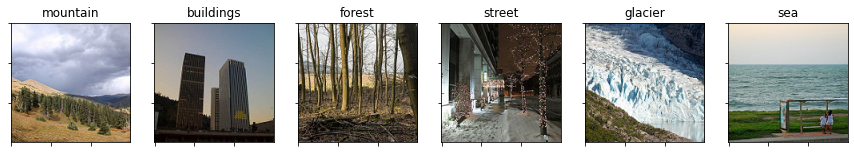

In [52]:
from os import listdir
from os.path import join

start_dir = './dataset/seg_test/seg_test'

class_dirs = [join(start_dir, dir) for dir in listdir(start_dir)]

fig, axis = plt.subplots(1, len(class_dirs), figsize=(15, 15))

for idx, dir in enumerate(class_dirs):
    img_loc = join(dir, listdir(dir)[0])
    img = Image.open(img_loc)
    img = np.array(img)

    axis[idx].imshow(img)
    axis[idx].set_xticklabels([])
    axis[idx].set_yticklabels([])
    axis[idx].set_aspect('equal')
    axis[idx].set_title(dir.split('/')[-1])

In [53]:
img_loc = join(class_dirs[0], listdir(class_dirs[0])[0])
img = Image.open(img_loc)
img = np.array(img)

print(img.shape)

(150, 150, 3)


## Create datasets


In [54]:
import pandas as pd
from collections import Counter

test_dir = 'dataset/seg_test/seg_test'
train_dir = 'dataset/seg_train/seg_train'

train_files_x = []
train_labels_y = []
val_files_x = []
val_labels_y = []

# Get directories and labes for train and val datasets
for dir in (join(train_dir, dir) for dir in listdir(train_dir)):
    new_inst = [join(dir, f) for f in listdir(dir)]
    new_inst_train, new_inst_val = np.split(new_inst, [int(len(new_inst)*0.8)])
    train_files_x += new_inst_train.tolist()
    train_labels_y += [dir.split('/')[-1]]*len(new_inst_train)
    val_files_x += new_inst_val.tolist()
    val_labels_y += [dir.split('/')[-1]]*len(new_inst_val)

test_files_x = []
test_labels_y = []

# Get directories and labels for test datasets
for dir in (join(test_dir, dir) for dir in listdir(test_dir)):
    new_inst = [join(dir, f) for f in listdir(dir)]
    test_files_x += new_inst
    test_labels_y += [dir.split('/')[-1]]*len(new_inst)

# Oribinal labels by index
labels_original = list(Counter(train_labels_y).keys())
print(labels_original)

# One hot labels
train_labels_y = pd.factorize(train_labels_y)[0]
train_labels_y = np.eye(len(Counter(train_labels_y).keys()))[train_labels_y]

test_labels_y = pd.factorize(test_labels_y)[0]
test_labels_y = np.eye(len(Counter(test_labels_y).keys()))[test_labels_y]

val_labels_y = pd.factorize(val_labels_y)[0]
val_labels_y = np.eye(len(Counter(val_labels_y).keys()))[val_labels_y]

train_files_x = np.array(train_files_x)
val_files_x = np.array(val_files_x)
test_files_x = np.array(test_files_x)

['mountain', 'buildings', 'forest', 'street', 'glacier', 'sea']


In [59]:
class ImageDataset(Dataset):
    def __init__(self, images, labels):
        self.images = images
        self.labels = labels

    def __len__(self):
        return len(self.images)

    def __getitem__(self, index):
        loc = self.images[index]

        label = self.labels[index]

        img = Image.open(loc).convert('RGB')
        img = transforms.ToTensor()(img)
        img = transforms.Resize((150, 150))(img)
        img = transforms.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.244, 0.225]
            )(img)

        return (img, label)

In [60]:
train_dataset = ImageDataset(train_files_x, train_labels_y)
train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)

test_dataset = ImageDataset(test_files_x, test_labels_y)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=True)

val_dataset = ImageDataset(val_files_x, val_labels_y)
val_loader = DataLoader(val_dataset, batch_size=64, shuffle=True)

#### Test dataloaders

In [57]:
def inv_normalize_image(image):
    image = transforms.Normalize(
            mean=[-0.485 / 0.229, -0.456 / 0.244, -0.406 / 0.225],
            std=[1.0/0.229, 1.0/0.244, 1.0/0.225]
        )(image)
    return image

torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0401DD0>


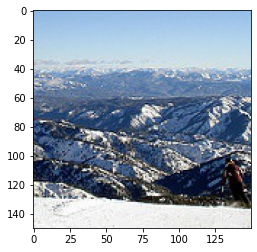

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12ACFEDA10>


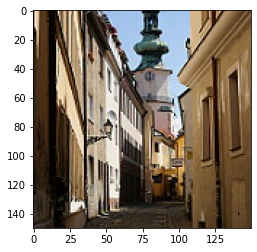

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12AD12D390>


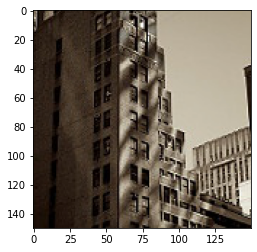

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B06F3810>


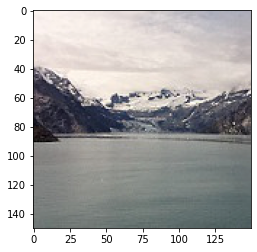

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B034D090>


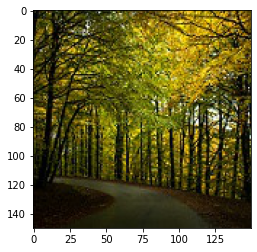

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0503450>


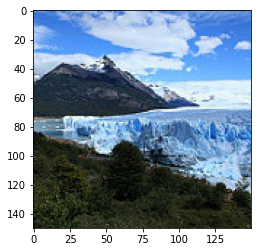

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0A21690>


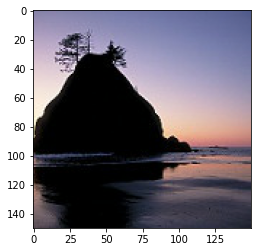

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B08ADC10>


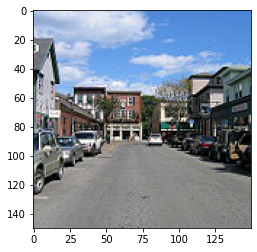

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B09995D0>


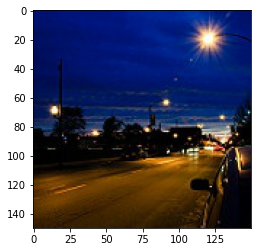

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B07D5FD0>


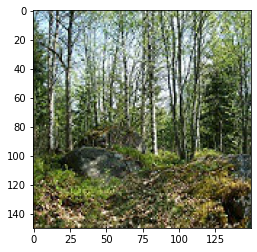

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B1834090>


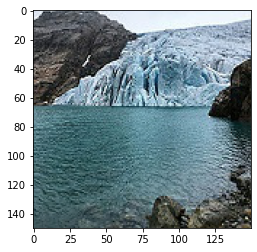

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B1997910>


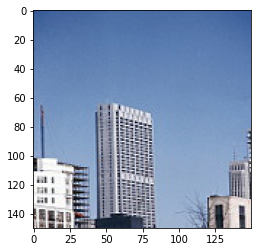

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B1AE3C10>


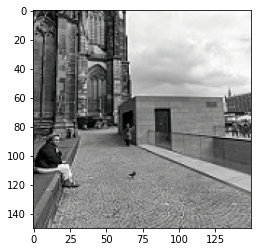

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0531F10>


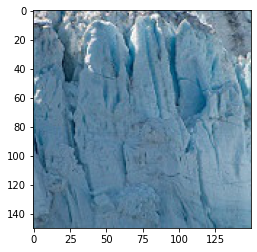

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12ACFC7190>


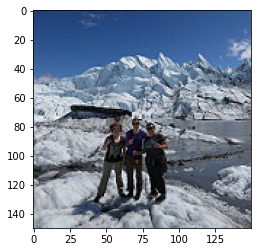

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B06D0C50>


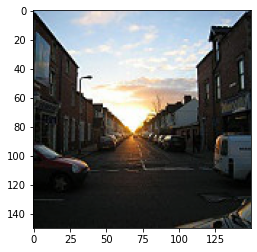

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B1811710>


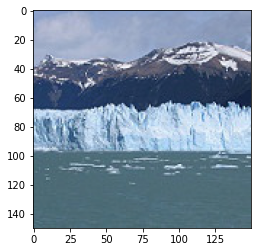

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12ACFA8B90>


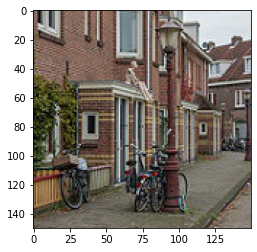

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B1AE3BD0>


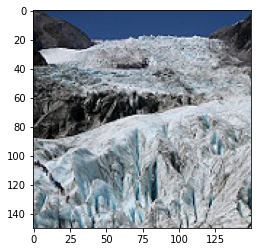

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0AA0C50>


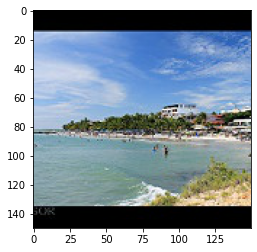

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0AA0A10>


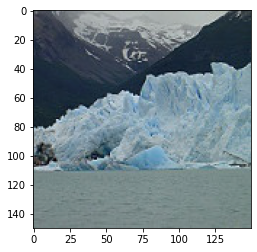

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B09FC2D0>


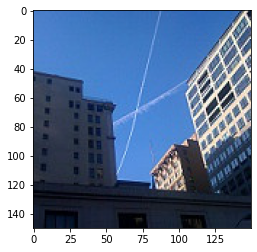

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0A28F50>


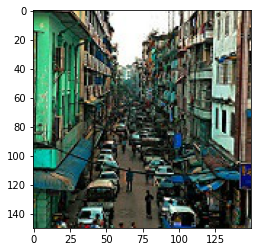

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0A48C50>


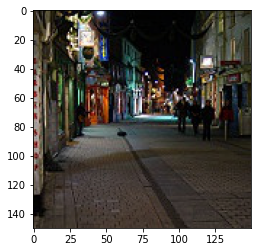

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B09FFD10>


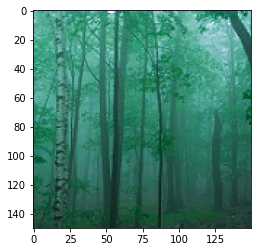

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12AD3ADED0>


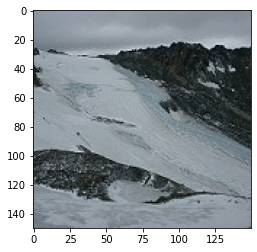

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0B631D0>


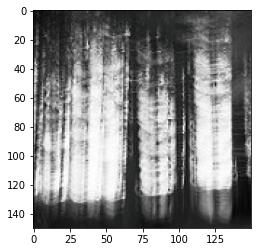

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B063FD50>


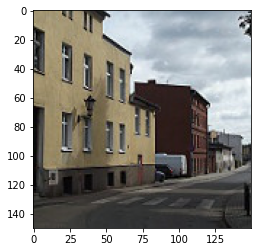

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B035C990>


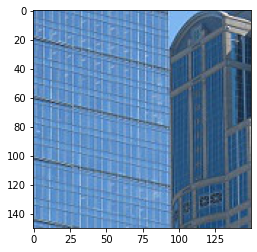

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12ACAF7710>


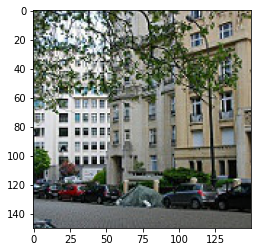

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0B2D490>


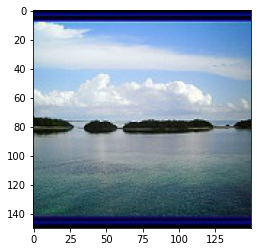

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B1932790>


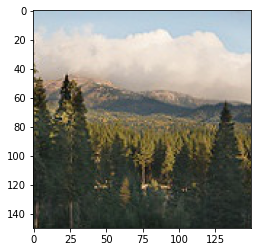

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12ACAFD310>


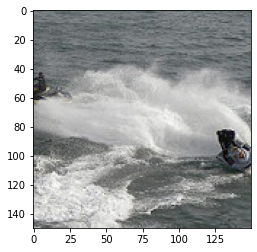

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0AAE790>


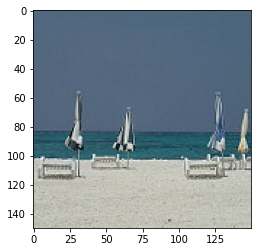

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B08EC750>


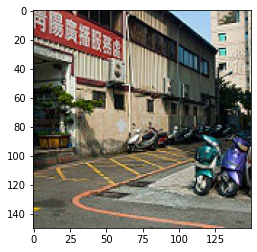

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B036D550>


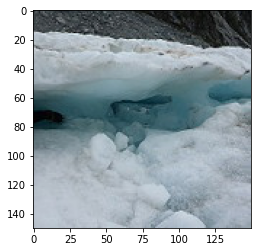

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B07D8790>


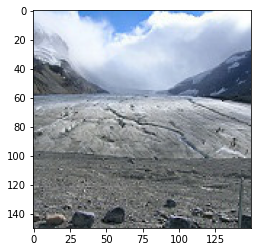

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B09F1C90>


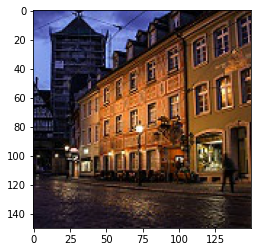

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12AC8CACD0>


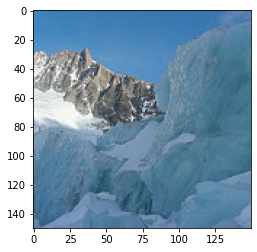

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B09FF090>


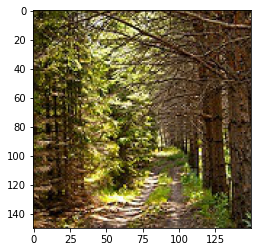

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0A9E090>


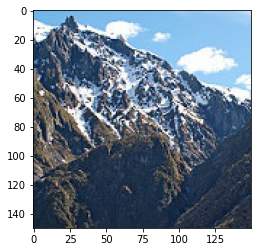

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0A9EED0>


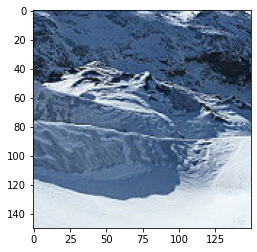

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B0A16690>


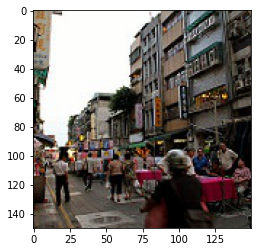

#################################
torch.Size([58, 3, 150, 150])
torch.Size([58, 6])
glacier
<PIL.Image.Image image mode=RGB size=150x150 at 0x7F12B07D5150>


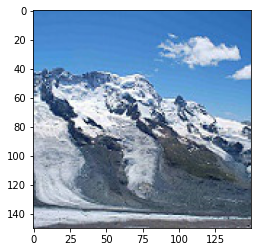

#################################


In [61]:
for data, target in val_loader:
    print(data.shape)
    print(target.shape)

    print(labels_original[np.argmax(target[0])])

    img = inv_normalize_image(data[0])
    img = transforms.ToPILImage()(img)
    print(img)
    plt.imshow(img)
    plt.show()
    print('#################################')

torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


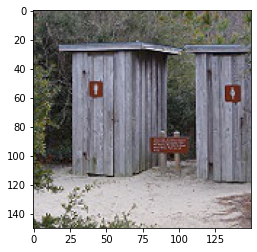

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


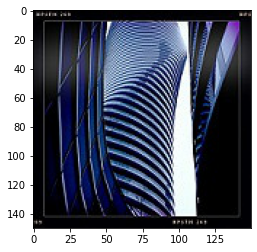

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


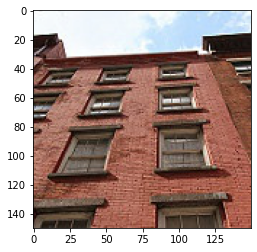

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


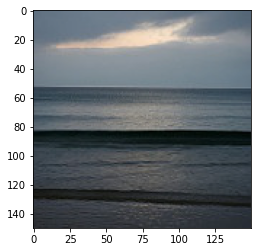

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


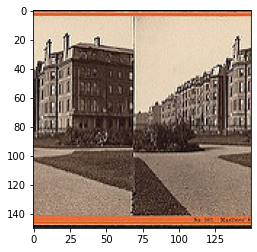

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


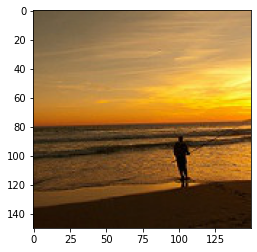

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


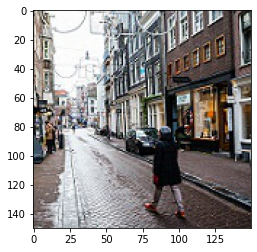

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


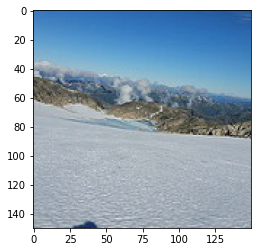

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


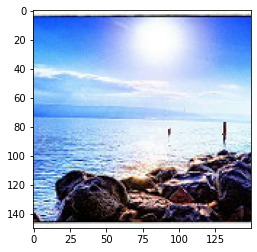

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


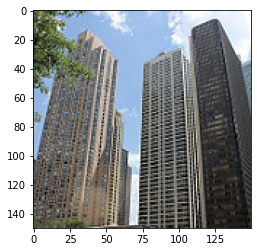

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


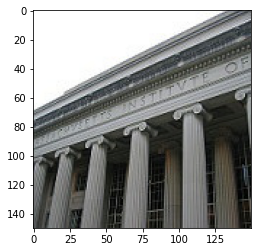

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


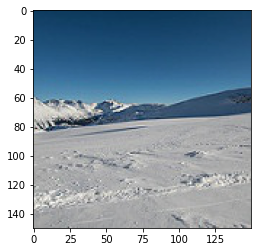

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


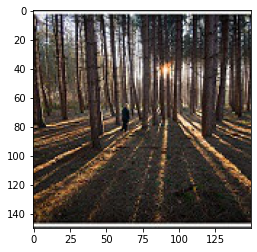

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


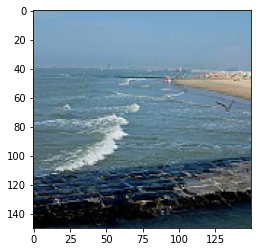

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


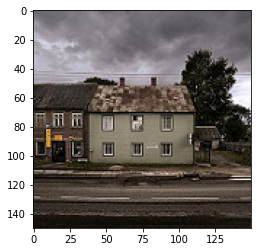

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


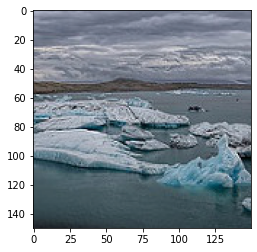

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


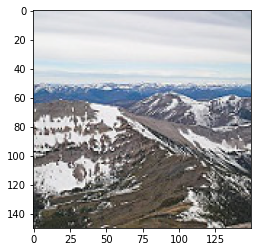

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


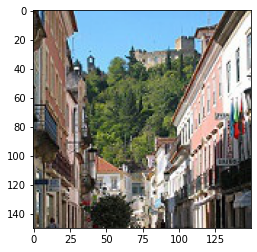

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


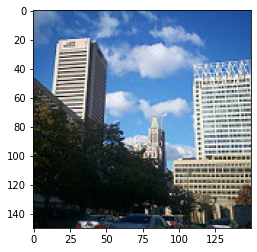

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


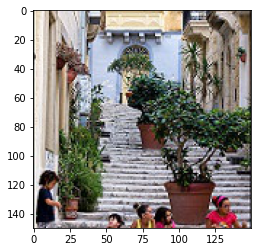

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


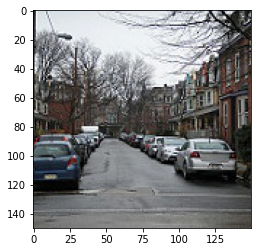

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


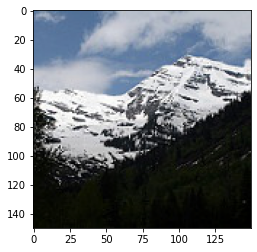

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


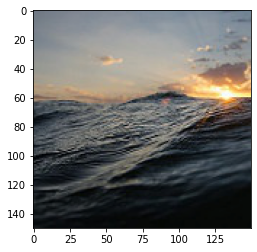

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


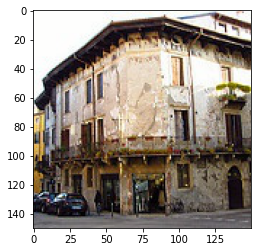

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


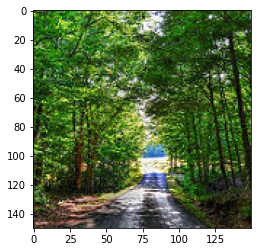

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


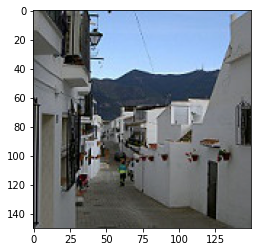

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


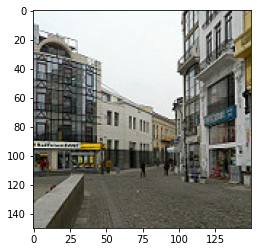

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


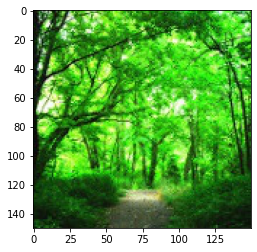

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


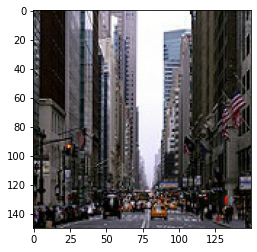

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


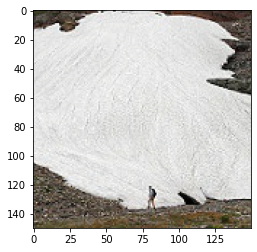

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


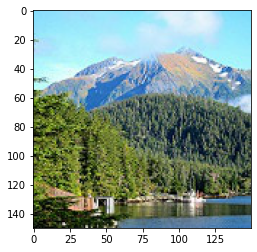

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


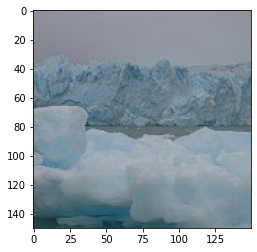

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


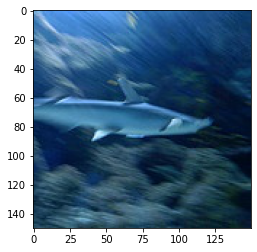

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


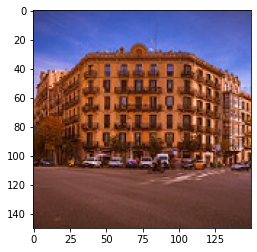

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


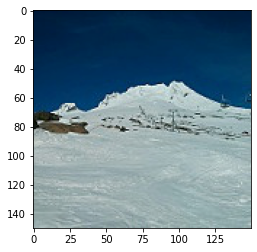

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


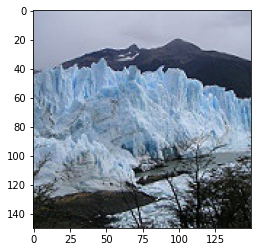

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


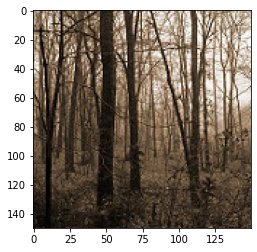

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


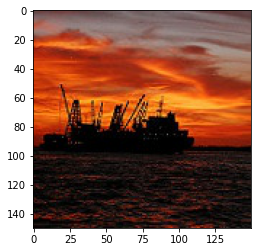

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


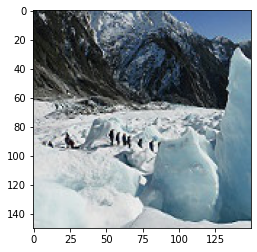

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


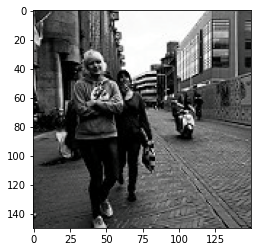

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


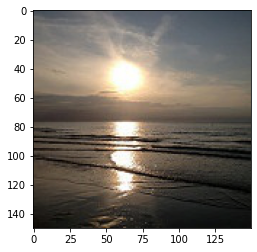

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


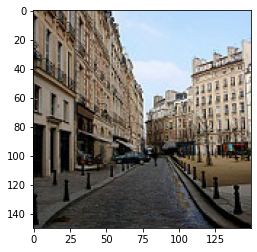

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


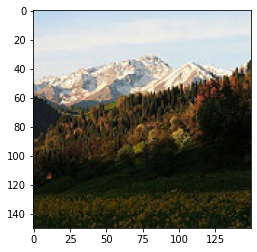

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


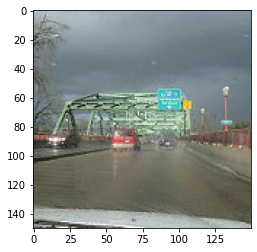

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


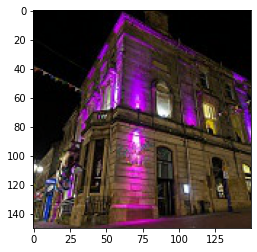

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


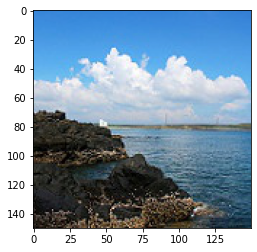

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


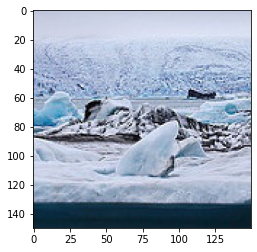

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


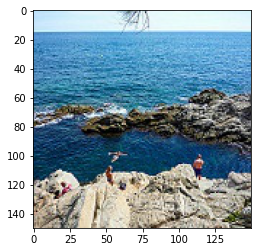

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


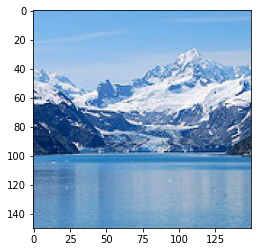

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


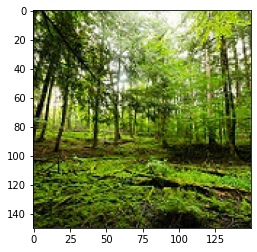

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


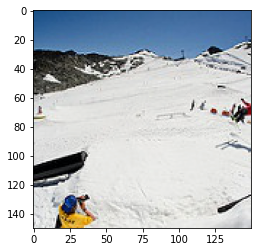

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


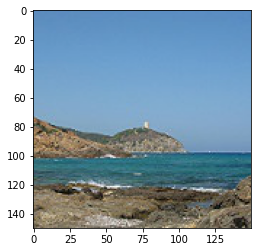

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


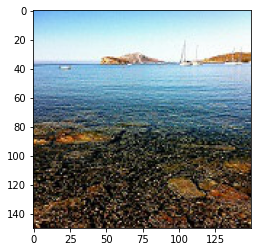

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


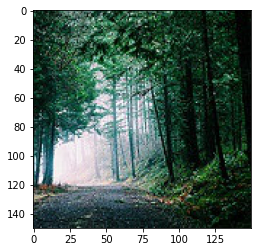

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


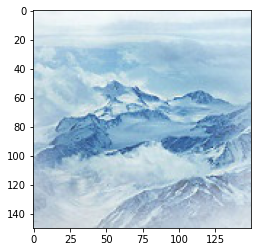

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


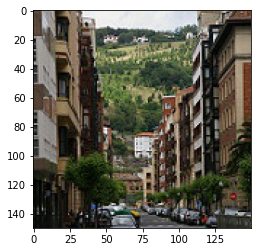

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


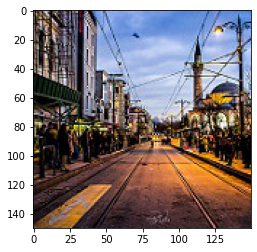

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


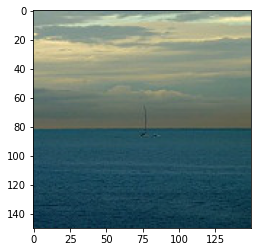

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


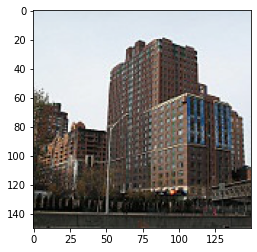

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


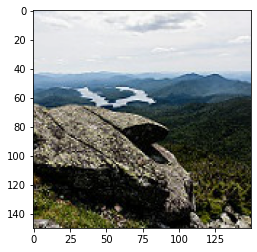

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


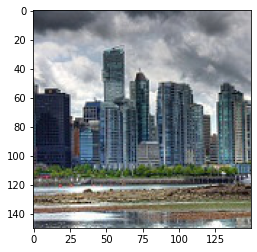

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


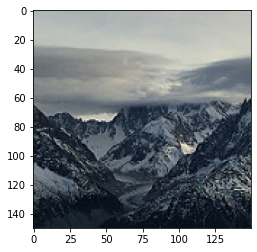

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


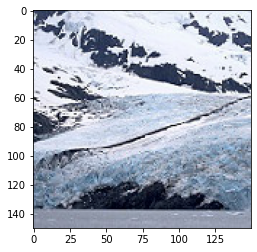

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


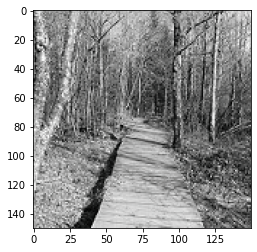

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


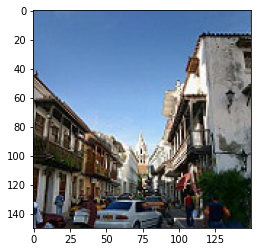

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


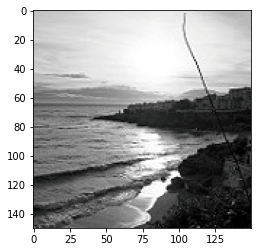

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


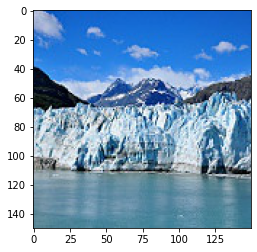

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


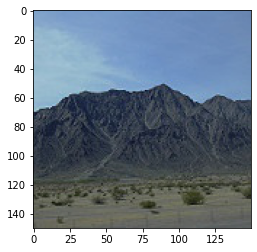

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


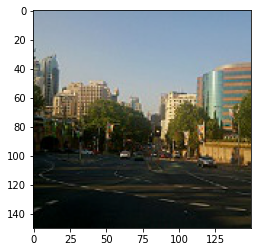

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


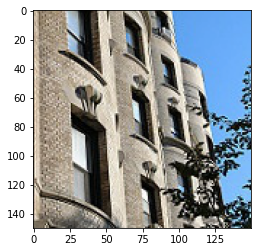

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


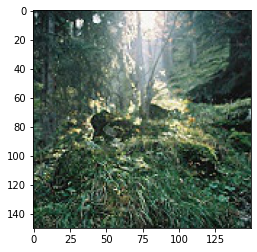

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


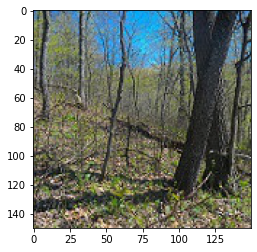

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


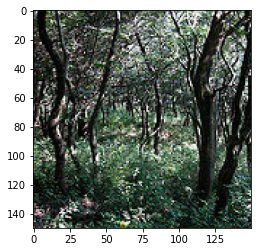

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


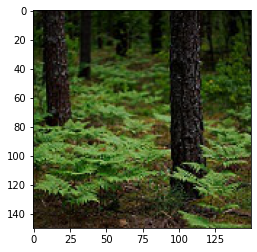

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


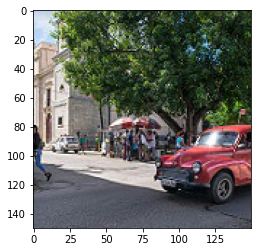

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


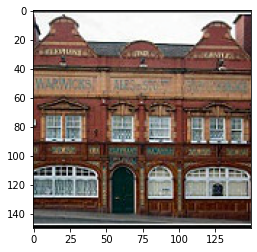

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


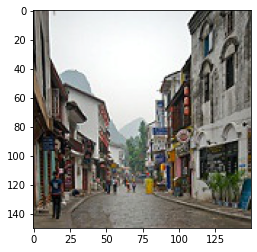

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


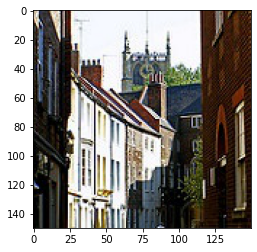

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


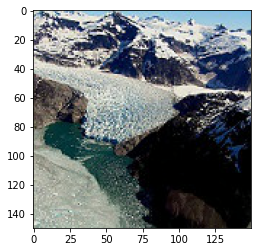

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


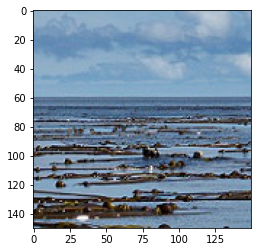

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


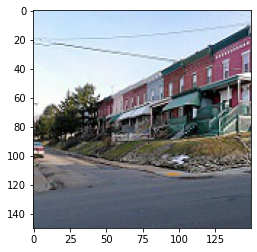

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


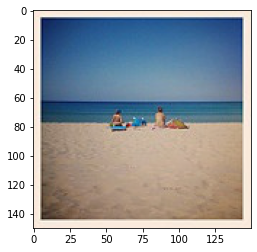

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


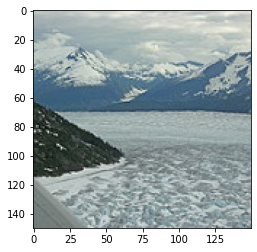

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


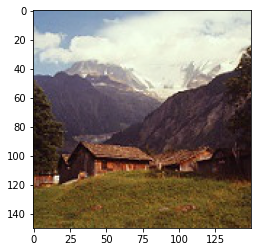

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


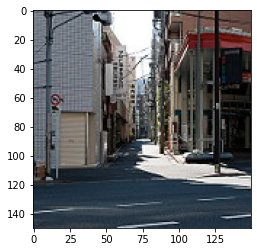

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


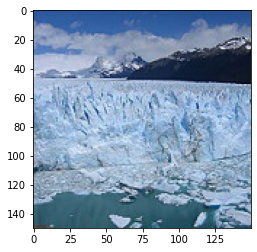

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


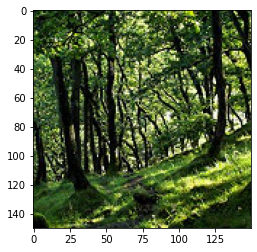

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


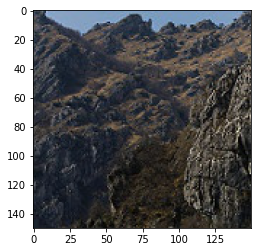

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


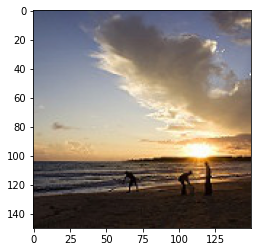

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


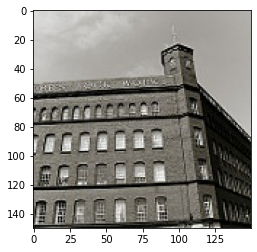

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


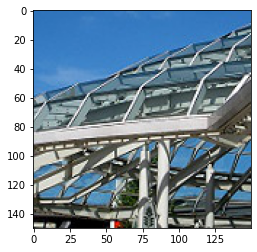

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


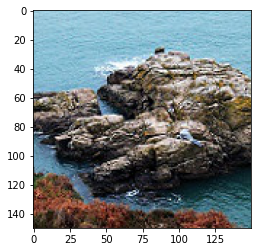

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


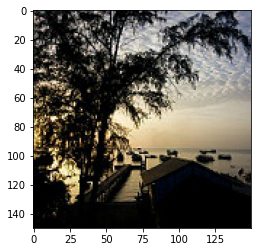

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


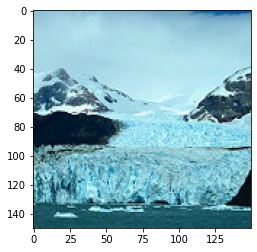

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


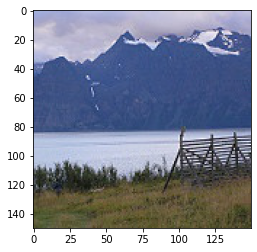

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


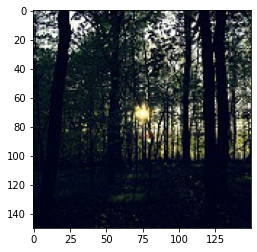

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


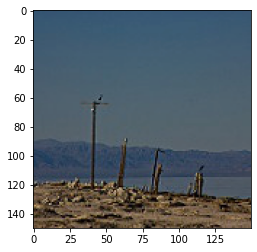

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


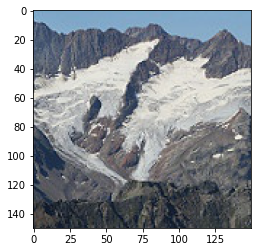

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


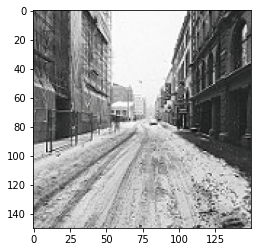

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


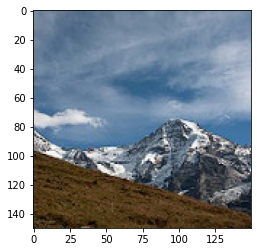

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


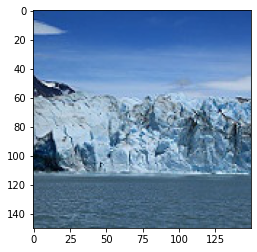

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


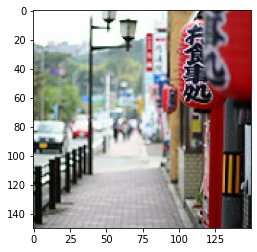

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


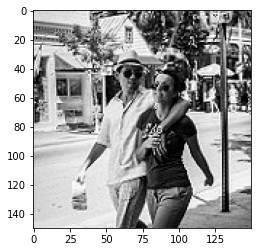

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


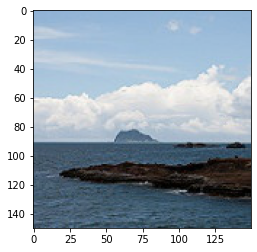

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


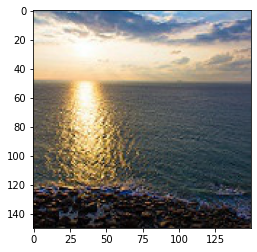

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


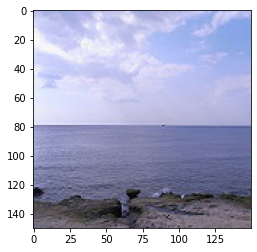

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


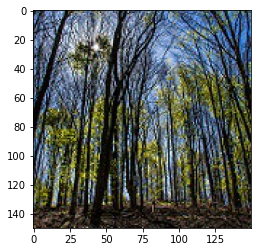

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


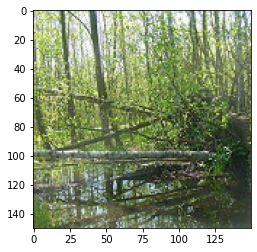

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


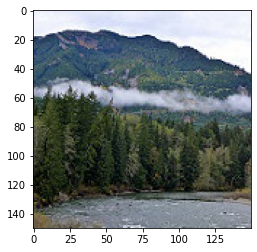

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


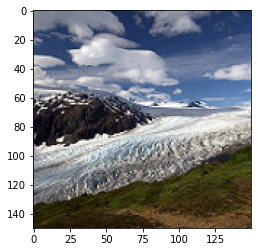

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


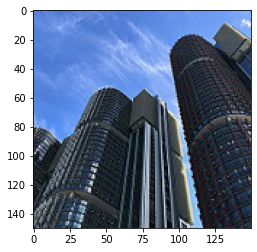

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


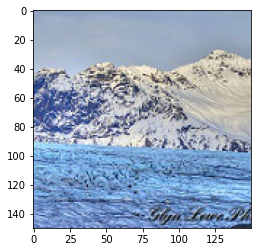

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


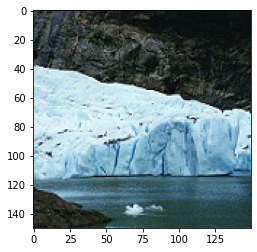

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


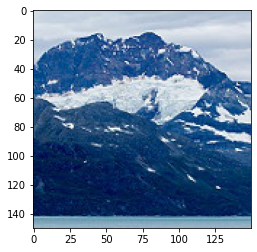

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


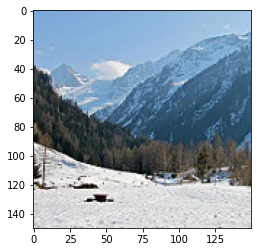

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


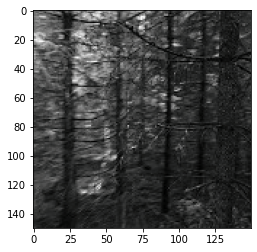

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


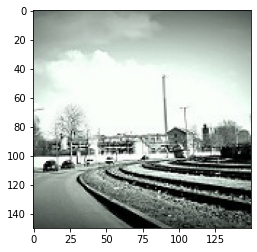

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


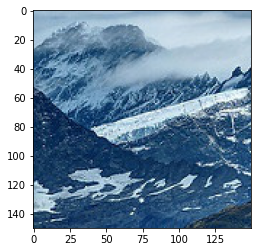

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


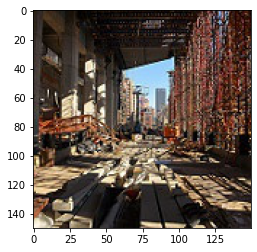

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


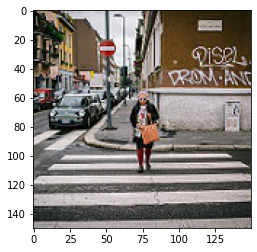

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


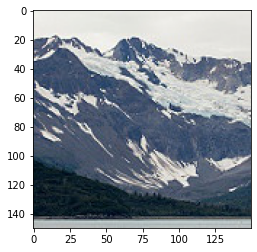

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


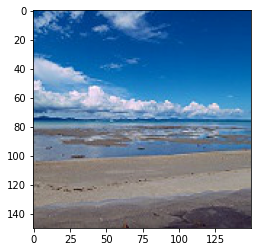

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


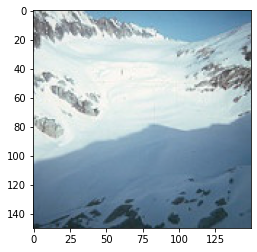

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


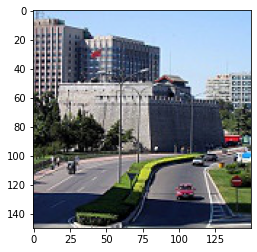

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


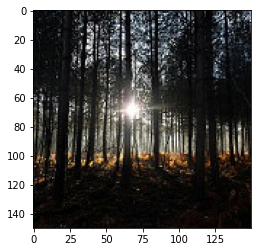

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


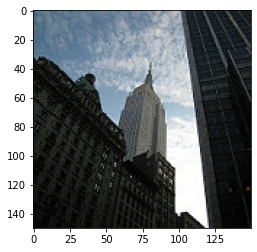

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


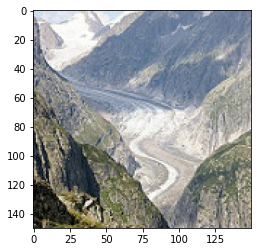

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


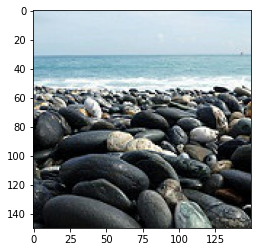

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


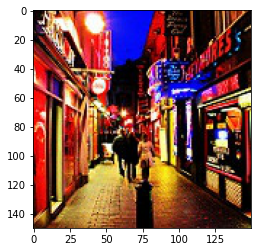

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


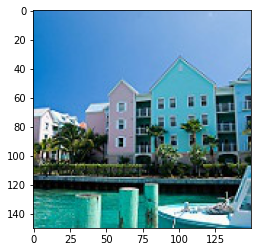

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


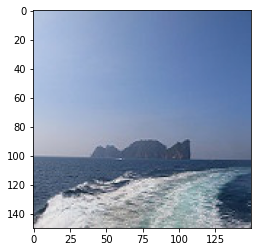

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


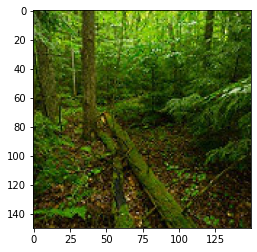

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


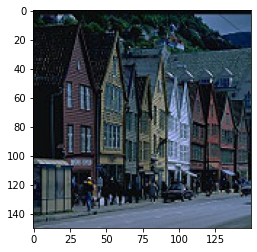

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


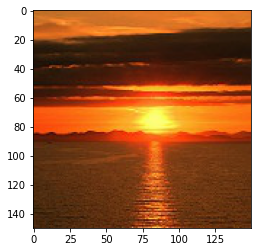

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


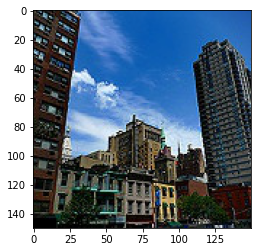

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


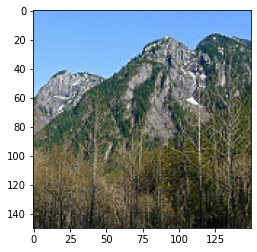

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


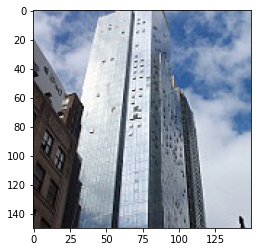

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


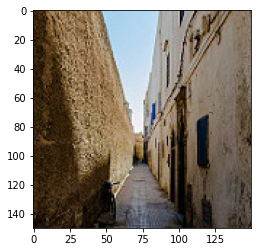

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


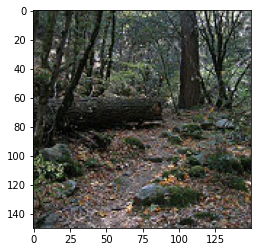

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


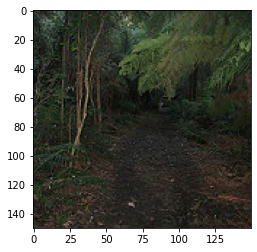

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


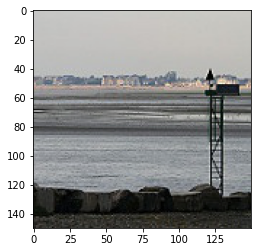

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


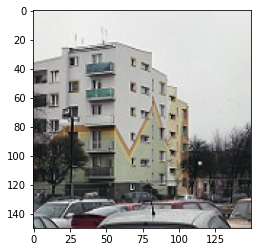

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


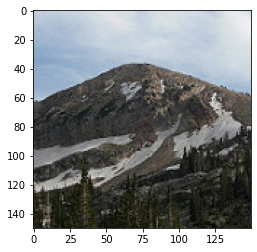

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


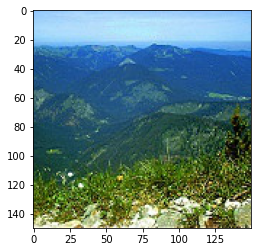

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


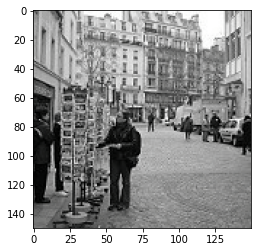

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


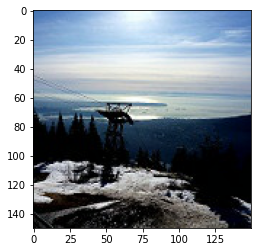

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


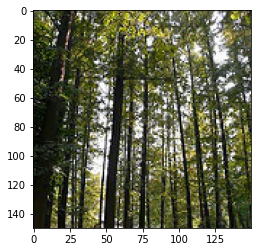

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


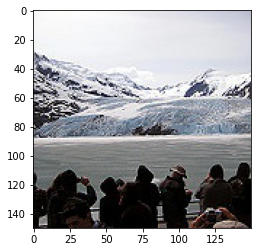

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


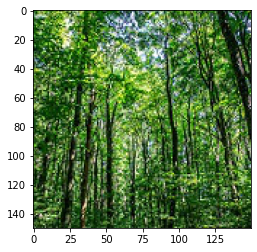

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


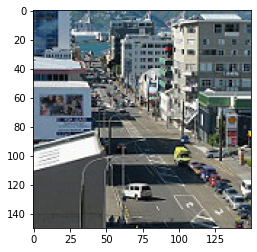

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


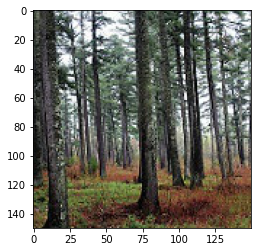

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


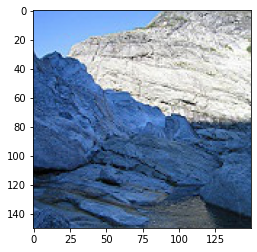

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


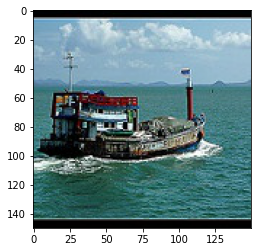

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


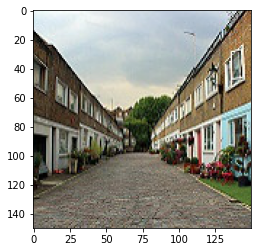

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


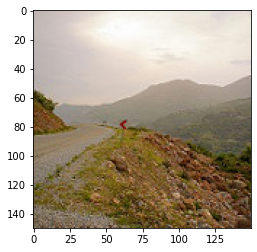

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


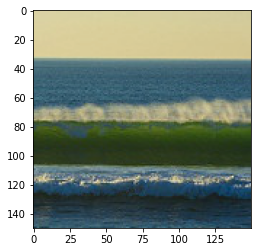

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


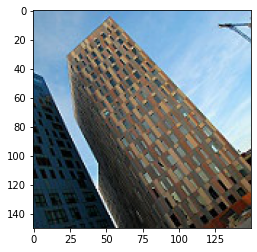

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


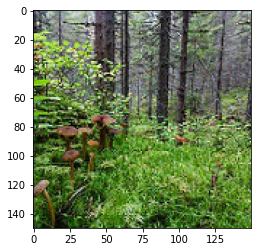

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


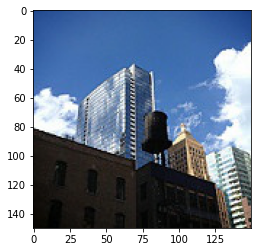

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


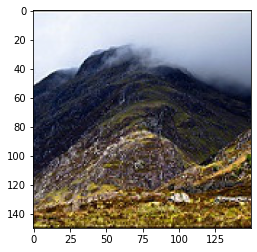

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


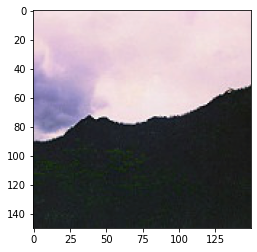

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


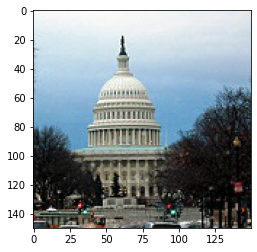

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


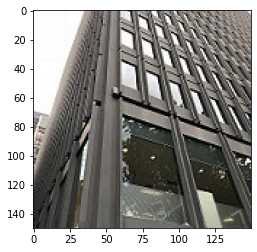

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


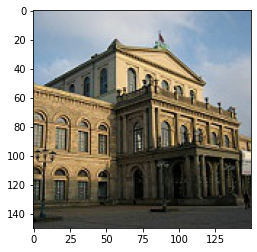

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


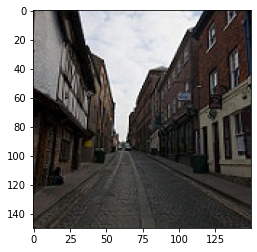

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


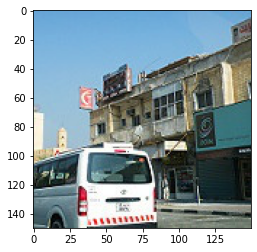

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


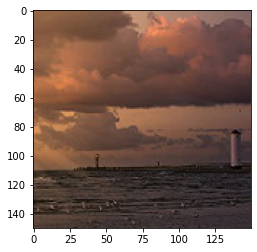

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


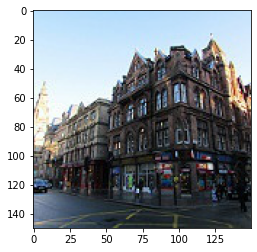

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


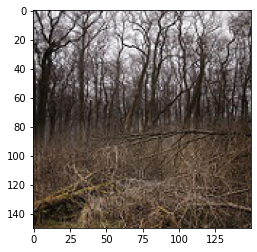

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


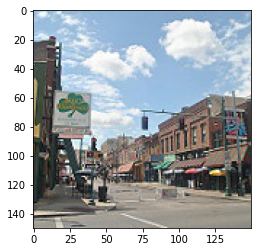

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


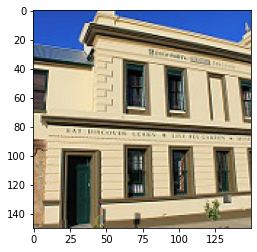

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


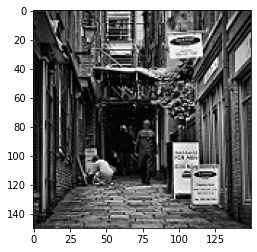

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


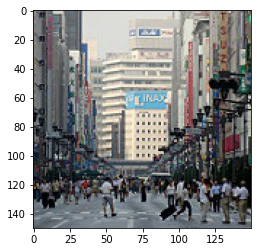

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


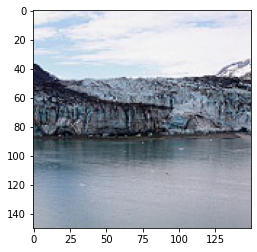

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


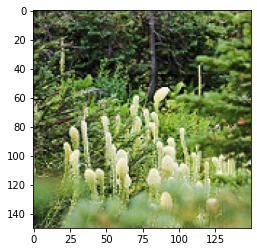

#################################
torch.Size([24, 3, 150, 150])
torch.Size([24, 6])
buildings


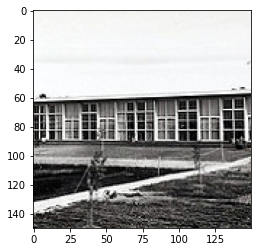

#################################


In [62]:
for data, target in train_loader:
    print(data.shape)
    print(target.shape)

    print(labels_original[np.argmax(target[0])])

    img = inv_normalize_image(data[0])
    img = transforms.ToPILImage()(img)
    plt.imshow(img)
    plt.show()
    print('#################################')

torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


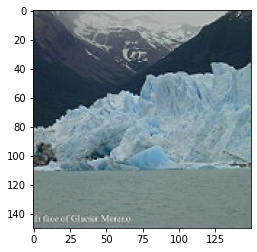

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


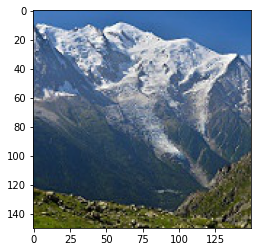

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


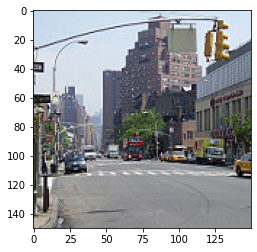

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


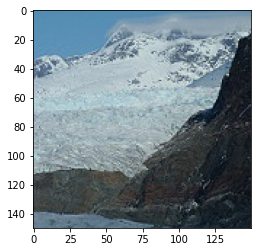

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


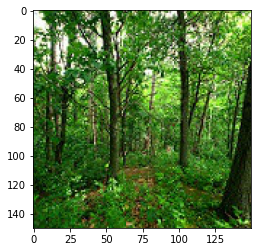

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


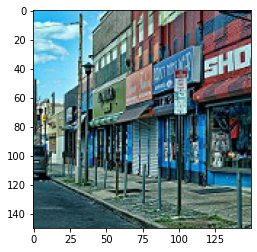

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


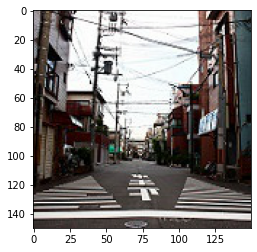

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


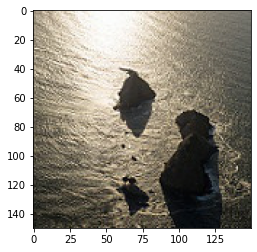

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


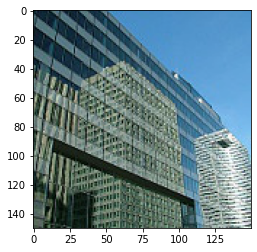

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
glacier


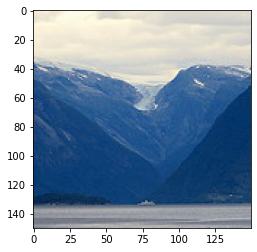

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


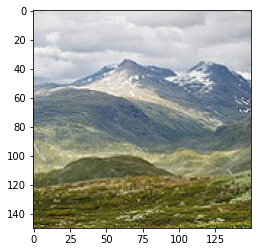

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


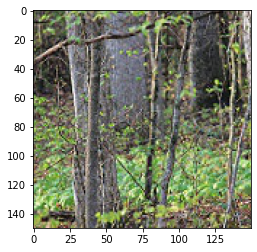

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


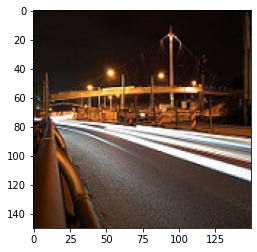

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


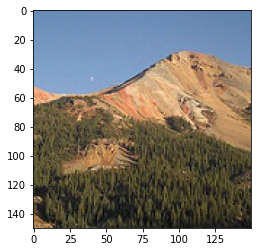

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


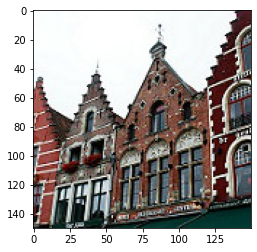

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


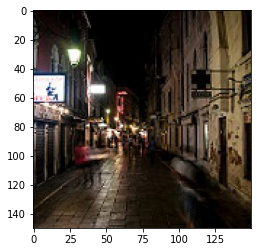

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


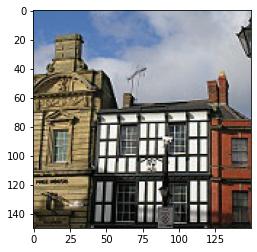

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


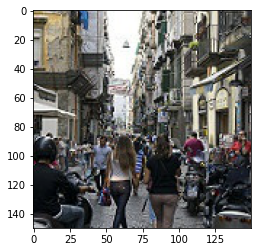

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


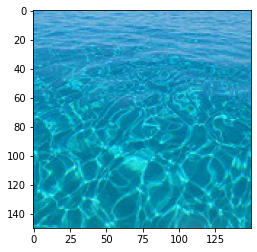

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


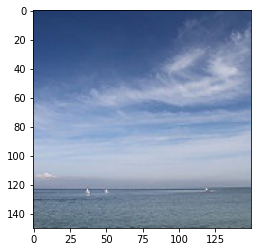

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


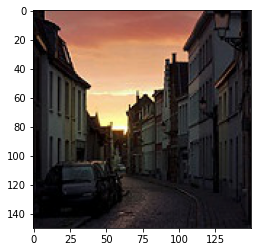

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


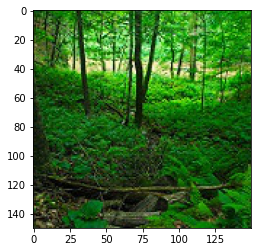

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


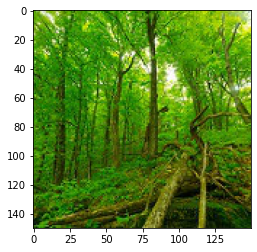

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


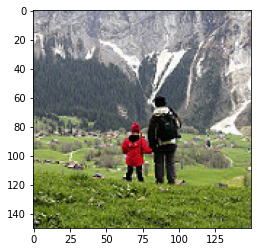

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


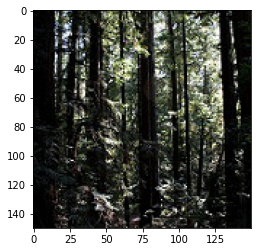

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


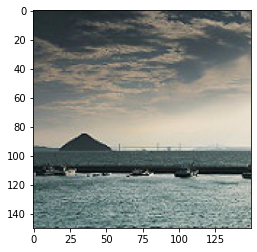

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


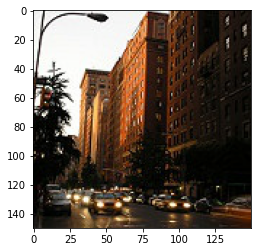

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


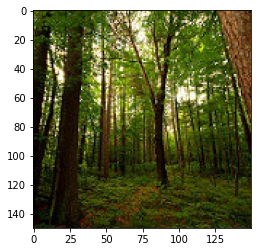

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


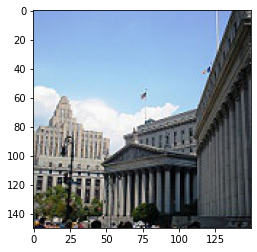

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


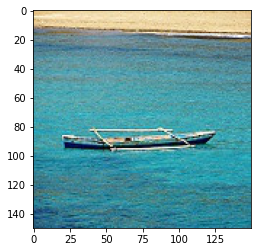

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


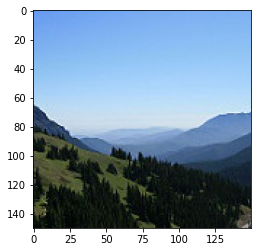

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


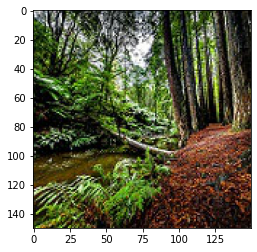

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


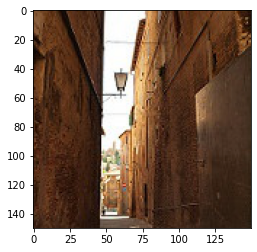

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


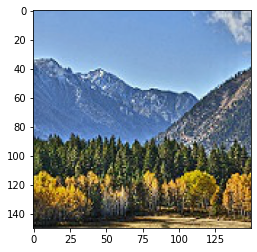

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


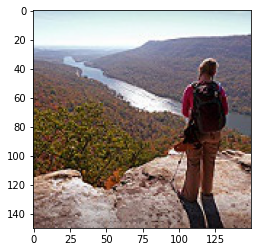

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


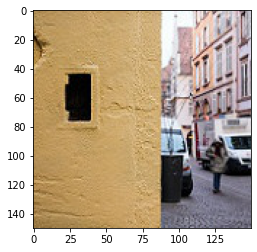

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


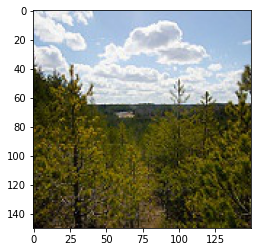

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


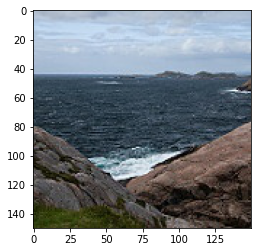

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


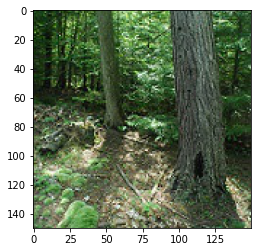

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


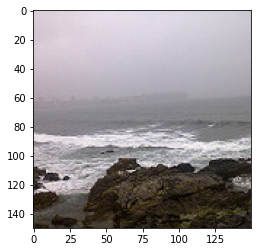

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


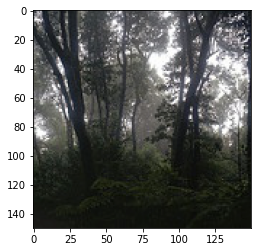

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
street


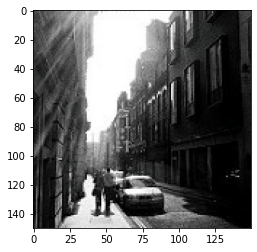

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
buildings


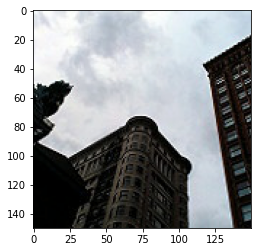

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
sea


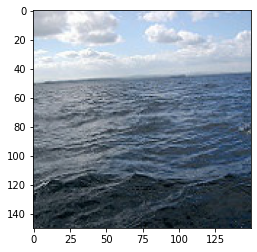

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
mountain


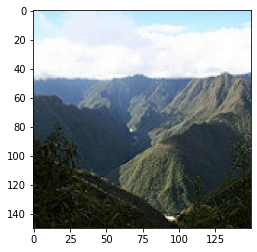

#################################
torch.Size([64, 3, 150, 150])
torch.Size([64, 6])
forest


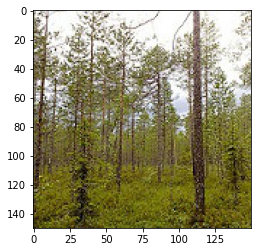

#################################
torch.Size([56, 3, 150, 150])
torch.Size([56, 6])
street


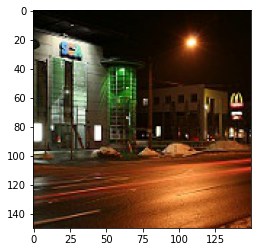

#################################


In [63]:
for data, target in test_loader:
    print(data.shape)
    print(target.shape)

    print(labels_original[np.argmax(target[0])])

    img = inv_normalize_image(data[0])
    img = transforms.ToPILImage()(img)
    plt.imshow(img)
    plt.show()
    print('#################################')

## Training functions

In [64]:
import time

def train(model, optimizer, train_data, val_data, test_data, num_epochs, device='cuda'):
    history = {}
    history['train_loss'] = []
    history['train_acc'] = []
    history['val_loss'] = []
    history['val_acc'] = []

    history['test_loss'] = 0
    history['test_acc'] = 0

    start_time = time.time()

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch+1, num_epochs))

        epoch_time = time.time()

        tr_loss, tr_acc = train_step(model, optimizer, train_data, epoch+1, num_epochs, device)
        history['train_loss'].append(tr_loss)
        history['train_acc'].append(tr_acc)

        vl_loss, vl_acc = validate(model, optimizer, val_data, epoch+1, num_epochs, device)
        history['val_loss'].append(vl_loss)
        history['val_acc'].append(vl_acc)

        epoch_time = time.time() - epoch_time
        print('Epoch completed in {:.0f}m {:.0f}s'.format(
            epoch_time // 60, epoch_time % 60))
        print('#' * 20)
        print()

    ts_loss, ts_acc = test(model, optimizer, test_data, epoch+1, num_epochs, device)
    history['test_loss'] = ts_loss
    history['test_acc'] = ts_acc

    start_time = time.time() - start_time
    print('Model trained in {:.0f}m {:.0f}s'.format(
    start_time // 60, start_time % 60))

    return history

In [65]:
def train_step(model, optimizer, train_data, epoch, epochs, device='cuda'):
    losses = []
    accs = []

    max_size = len(train_data.dataset)
    idx = 0
    idx_step = 0.0

    model.train()

    for data, target in train_data:
        idx += len(data)

        model.zero_grad()

        data = data.to(device)
        target = target.to(device)

        pred, _ = model(data)
        loss = loss_fn(pred, target)

        loss.backward()
        optimizer.step()

        losses.append(loss.item())
        pred = torch.argmax(pred, dim=1)
        target = torch.argmax(target, dim=1)
        accs.append(torch.sum(pred == target).item() / len(data))

        if (max_size * idx_step) <= idx:

            l = sum(losses) / len(losses)
            a = sum(accs) / len(accs)

            print_status('Train', epoch, epochs, l, a * 100, max_size * idx_step, max_size)

            idx_step += 0.2

    loss = sum(losses) / len(losses)
    acc = sum(accs) / len(accs)

    return loss, acc

In [66]:
def validate(model, optimizer, val_data, epoch, epochs, device='cuda'):
    losses = []
    accs = []

    model.eval()

    with torch.no_grad():
        for idx, (data, target) in enumerate(val_data):
            data = data.to(device)
            target = target.to(device)

            pred, _ = model(data)
            loss = loss_fn(pred, target)

            losses.append(loss.item())
            pred = torch.argmax(pred, dim=1)
            target = torch.argmax(target, dim=1)
            accs.append(torch.sum(pred == target).item() / len(data))

    loss = sum(losses) / len(losses)
    acc = sum(accs) / len(accs)

    print_status('Validate', epoch, epochs, loss, acc * 100)

    return loss, acc

In [67]:
def test(model, optimizer, test_data, epoch, epochs, device='cuda'):
    losses = []
    accs = []

    model.eval()

    with torch.no_grad():
        for idx, (data, target) in enumerate(test_data):
            data = data.to(device)
            target = target.to(device)

            pred, _ = model(data)
            loss = loss_fn(pred, target)

            losses.append(loss.item())
            pred = torch.argmax(pred, dim=1)
            target = torch.argmax(target, dim=1)
            accs.append(torch.sum(pred == target).item() / len(data))

    loss = sum(losses) / len(losses)
    acc = sum(accs) / len(accs)

    print_status('Test', epoch, epochs, loss, acc * 100)

    return loss, acc

In [68]:
def print_status(mode, epoch, epochs, loss, acc, idx = 0, max_idx = 0):
    s = mode
    if mode == "Validate":
        s += '\t({:2d}/{:2d})'.format(epoch, epochs)
    elif mode == "Train":
        s += '\t({:2d}/{:2d}) {:4.0f}/{:4d} ({:2.2f}%)'.format(
            epoch, epochs, idx, max_idx, idx/max_idx*100
        )

    s += ' loss: {:.3f}'.format(loss)
    s += ' accuracy: {:.3f}'.format(acc)

    print(s)

## Model

In [69]:
class VGG(nn.Module):
    def __init__(self, in_channels, classes):
        super(VGG, self).__init__()

        self.features = nn.Sequential(
            nn.Conv2d(in_channels, 64, kernel_size=3, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),

            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(64, 128, kernel_size=3, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(128, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Conv2d(256, 256, kernel_size=3, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),

            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(256, 512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),

            nn.MaxPool2d(kernel_size=2),

            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, 512, kernel_size=3, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),

            nn.MaxPool2d(kernel_size=2),
        )

        self.avgpool = nn.AdaptiveAvgPool2d(7)

        self.classifier = nn.Sequential(
            nn.Linear(512 * 7 * 7, 4096),
            nn.ReLU(inplace=True),
            nn.Linear(4096, 4096),
            nn.ReLU(inplace=True),
            nn.Dropout(0.5),
            nn.Linear(4096, classes)
        )

    def forward(self, x):
        x = self.features(x)
        x = self.avgpool(x)
        h = x.view(x.shape[0], -1)
        x = self.classifier(h)
        return x, h

#### Test model

Chech if everything passes correctly

In [70]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
loss_fn = nn.CrossEntropyLoss()
vgg11 = VGG(3, len(labels_original)).to(device)
optimizer = optim.Adam(vgg11.parameters(), lr=0.002, betas=(0.9, 0.999))

summary(vgg11, (3, 150, 150))

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 150, 150]           1,792
       BatchNorm2d-2         [-1, 64, 150, 150]             128
              ReLU-3         [-1, 64, 150, 150]               0
         MaxPool2d-4           [-1, 64, 75, 75]               0
            Conv2d-5          [-1, 128, 75, 75]          73,856
       BatchNorm2d-6          [-1, 128, 75, 75]             256
              ReLU-7          [-1, 128, 75, 75]               0
         MaxPool2d-8          [-1, 128, 37, 37]               0
            Conv2d-9          [-1, 256, 37, 37]         295,168
      BatchNorm2d-10          [-1, 256, 37, 37]             512
             ReLU-11          [-1, 256, 37, 37]               0
           Conv2d-12          [-1, 256, 37, 37]         590,080
      BatchNorm2d-13          [-1, 256, 37, 37]             512
             ReLU-14          [-1, 256,

Check if functions work

In [71]:
one_dataset = ImageDataset([train_files_x[0]], torch.tensor([train_labels_y[0]]))
one_loader = DataLoader(one_dataset, batch_size=1, shuffle=True)

two_dataset = ImageDataset([val_files_x[1]], torch.tensor([val_labels_y[1]]))
two_loader = DataLoader(two_dataset, batch_size=1, shuffle=True)

three_dataset = ImageDataset([test_files_x[2]], torch.tensor([test_labels_y[2]]))
three_loader = DataLoader(three_dataset, batch_size=1, shuffle=True)

history = train(vgg11, optimizer, one_loader, two_loader, three_loader, 2, device=device)

Epoch 1/2
Train	( 1/ 2)    0/   1 (0.00%) loss: 1.931 accuracy: 0.000
Validate	( 1/ 2) loss: 0.000 accuracy: 100.000
Epoch completed in 0m 0s
####################

Epoch 2/2
Train	( 2/ 2)    0/   1 (0.00%) loss: 0.000 accuracy: 100.000
Validate	( 2/ 2) loss: 0.000 accuracy: 100.000
Epoch completed in 0m 0s
####################

Test loss: 0.000 accuracy: 100.000
Model trained in 0m 0s


Check if model is updated

In [72]:
idx_train = np.round(np.linspace(0, len(train_labels_y) - 1, 16)).astype(int)
idx_val = np.round(np.linspace(0, len(val_labels_y) - 1, 16)).astype(int)
idx_test = np.round(np.linspace(0, len(test_labels_y) - 1, 16)).astype(int)
# train_files_x[idx_train[0:2]]
idx_train

array([    0,   748,  1496,  2245,  2993,  3741,  4489,  5237,  5986,
        6734,  7482,  8230,  8978,  9727, 10475, 11223])

In [73]:
one_dataset = ImageDataset(train_files_x[idx_train], train_labels_y[idx_train])
one_loader = DataLoader(one_dataset, batch_size=4, shuffle=True)

two_dataset = ImageDataset(val_files_x[idx_val], val_labels_y[idx_val])
two_loader = DataLoader(two_dataset, batch_size=4, shuffle=True)

three_dataset = ImageDataset(test_files_x[idx_test], test_labels_y[idx_test])
three_loader = DataLoader(three_dataset, batch_size=4, shuffle=True)

history = train(vgg11, optimizer, one_loader, two_loader, three_loader, 2, device=device)

Epoch 1/2
Train	( 1/ 2)    0/  16 (0.00%) loss: 1394.841 accuracy: 0.000
Train	( 1/ 2)    3/  16 (20.00%) loss: 743.043 accuracy: 12.500
Train	( 1/ 2)    6/  16 (40.00%) loss: 562.995 accuracy: 8.333
Train	( 1/ 2)   10/  16 (60.00%) loss: 482.356 accuracy: 6.250
Validate	( 1/ 2) loss: 11126.447 accuracy: 18.750
Epoch completed in 0m 1s
####################

Epoch 2/2
Train	( 2/ 2)    0/  16 (0.00%) loss: 197.287 accuracy: 0.000
Train	( 2/ 2)    3/  16 (20.00%) loss: 143.346 accuracy: 12.500
Train	( 2/ 2)    6/  16 (40.00%) loss: 114.419 accuracy: 8.333
Train	( 2/ 2)   10/  16 (60.00%) loss: 93.010 accuracy: 6.250
Validate	( 2/ 2) loss: 382.811 accuracy: 18.750
Epoch completed in 0m 1s
####################

Test loss: 452.755 accuracy: 12.500
Model trained in 0m 3s


In [74]:
history

{'test_acc': 0.125,
 'test_loss': 452.7547436952591,
 'train_acc': [0.0625, 0.0625],
 'train_loss': [482.35589241981506, 93.01018744334579],
 'val_acc': [0.1875, 0.1875],
 'val_loss': [11126.447128295898, 382.81065762043]}

## Visualization

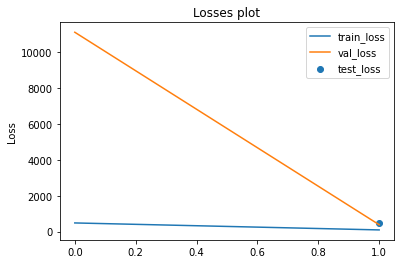

In [75]:
def visualize_loss(history):
    ind = list(range(len(history['train_loss'])))
    plt.plot(ind, history['train_loss'], label='line1')
    plt.plot(ind, history['val_loss'], label='line2')
    plt.scatter(ind[-1], history['test_loss'], label='point1')

    plt.legend([
        'train_loss',
        'val_loss',
        'test_loss'
    ])

    plt.ylabel('Loss')
    plt.title('Losses plot')
    plt.show()

visualize_loss(history)

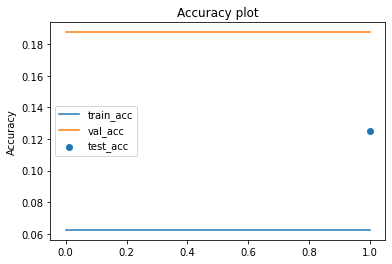

In [76]:
def visualize_acc(history):
    ind = list(range(len(history['train_acc'])))
    plt.plot(ind, history['train_acc'], label='line1')
    plt.plot(ind, history['val_acc'], label='line2')
    plt.scatter(ind[-1], history['test_acc'], label='point1')

    plt.legend([
        'train_acc',
        'val_acc',
        'test_acc'
    ])

    plt.ylabel('Accuracy')
    plt.title('Accuracy plot')
    plt.show()

visualize_acc(history)

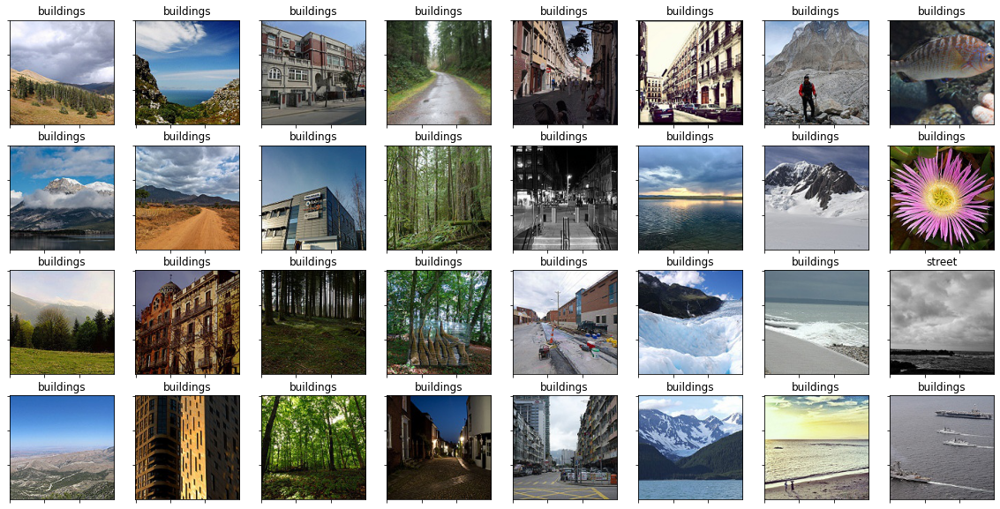

In [77]:
def plot_results(model):
    model.eval()

    idx = np.round(np.linspace(0, len(test_files_x) - 1, 32)).astype(int)
    images = test_files_x[idx]

    fig, axis = plt.subplots(4, 8, figsize=(20, 10))

    i = j = 0
    for idx, im in enumerate(images):

        img = Image.open(im).convert('RGB')
        img = transforms.ToTensor()(img)
        img = transforms.Resize((150, 150))(img)
        img = transforms.Normalize(
                mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.244, 0.225]
            )(img)

        img = img.to(device)

        pred, _ = model(img[None, ...])
        pred = torch.argmax(pred)

        img = img.to('cpu')

        pred = labels_original[pred]

        img = inv_normalize_image(img)
        img = img.permute(1, 2, 0)
        img = np.array(img)
        img[img > 1] = 1
        img[img < 0] = 0

        i = idx % 4
        j = idx // 4
        axis[i][j].imshow(img, cmap='gray')
        axis[i][j].set_title(pred)
        axis[i][j].set_xticklabels([])
        axis[i][j].set_yticklabels([])
        axis[i][j].set_aspect('equal')

plot_results(vgg11)

## Train

In [80]:
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
BATCH_SIZE = 64
loss_fn = nn.CrossEntropyLoss()
vgg11 = VGG(3, len(labels_original)).to(device)
optimizer = optim.Adam(vgg11.parameters(), lr=0.000003, betas=(0.8, 0.999))

In [81]:
train_dataset = ImageDataset(train_files_x, train_labels_y)
train_loader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True)

test_dataset = ImageDataset(test_files_x, test_labels_y)
test_loader = DataLoader(test_dataset, batch_size=BATCH_SIZE, shuffle=True)

val_dataset = ImageDataset(val_files_x, val_labels_y)
val_loader = DataLoader(val_dataset, batch_size=BATCH_SIZE, shuffle=True)

history = train(vgg11, optimizer, train_loader, val_loader, test_loader, 10, device=device)

Epoch 1/10
Train	( 1/10)    0/11224 (0.00%) loss: 1.798 accuracy: 17.188
Train	( 1/10) 2245/11224 (20.00%) loss: 1.515 accuracy: 42.925
Train	( 1/10) 4490/11224 (40.00%) loss: 1.325 accuracy: 50.440
Train	( 1/10) 6734/11224 (60.00%) loss: 1.208 accuracy: 54.864
Train	( 1/10) 8979/11224 (80.00%) loss: 1.131 accuracy: 57.458
Train	( 1/10) 11224/11224 (100.00%) loss: 1.065 accuracy: 60.112
Validate	( 1/10) loss: 0.773 accuracy: 72.449
Epoch completed in 3m 3s
####################

Epoch 2/10
Train	( 2/10)    0/11224 (0.00%) loss: 0.742 accuracy: 71.875
Train	( 2/10) 2245/11224 (20.00%) loss: 0.703 accuracy: 74.696
Train	( 2/10) 4490/11224 (40.00%) loss: 0.693 accuracy: 75.044
Train	( 2/10) 6734/11224 (60.00%) loss: 0.670 accuracy: 75.840
Train	( 2/10) 8979/11224 (80.00%) loss: 0.652 accuracy: 76.297
Train	( 2/10) 11224/11224 (100.00%) loss: 0.641 accuracy: 76.743
Validate	( 2/10) loss: 0.591 accuracy: 78.847
Epoch completed in 3m 3s
####################

Epoch 3/10
Train	( 3/10)    0/1122

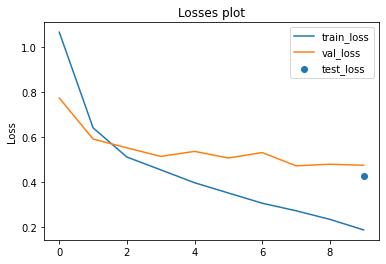

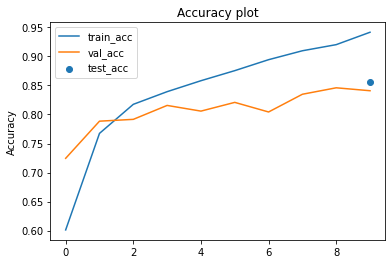

In [82]:
visualize_loss(history)
visualize_acc(history)

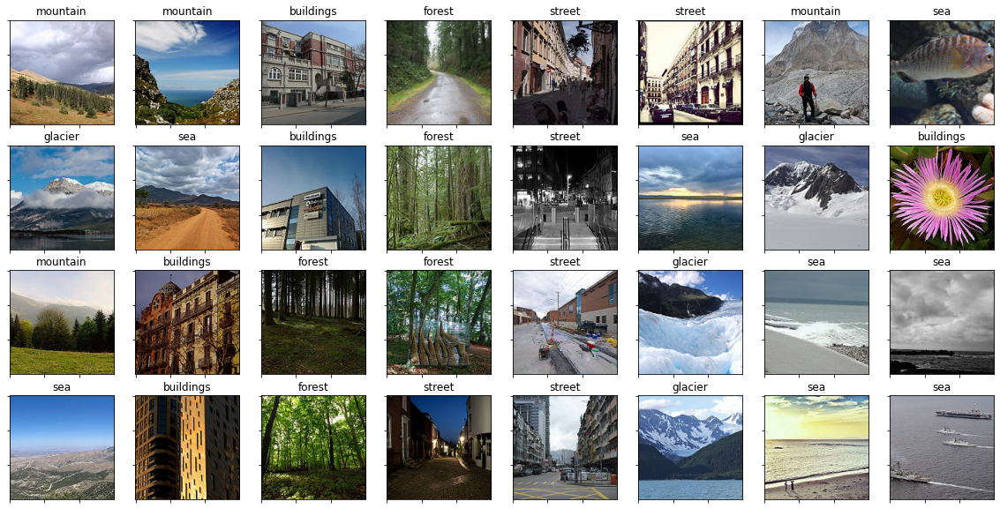

In [83]:
plot_results(vgg11)